In [36]:
!pip install plotly


[notice] A new release of pip is available: 24.2 -> 25.0
[notice] To update, run: python.exe -m pip install --upgrade pip


In [37]:
import os
import pandas as pd
import numpy as np
import plotly.express as px
import matplotlib
import matplotlib.pyplot as plt
import seaborn as sns
%matplotlib inline

pd.set_option('display.max_columns', None)
pd.set_option('display.max_rows', 150)
sns.set_style('darkgrid')
matplotlib.rcParams['font.size'] = 14
matplotlib.rcParams['figure.figsize'] = (10, 6)
matplotlib.rcParams['figure.facecolor'] = '#00000000'

In [7]:
stock_df = pd.read_csv('stock_dataset.csv')

In [8]:
stock_df = pd.DataFrame(stock_df)

In [9]:
stock_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 6145 entries, 0 to 6144
Data columns (total 16 columns):
 #   Column          Non-Null Count  Dtype  
---  ------          --------------  -----  
 0   Symbol          6112 non-null   object 
 1   Company Name    6112 non-null   object 
 2   Sector          6112 non-null   object 
 3   Industry        6112 non-null   object 
 4   Start Date      6112 non-null   object 
 5   Last Update     6112 non-null   object 
 6   Start Price     6112 non-null   float64
 7   Current Price   6112 non-null   float64
 8   YTD Change      6112 non-null   float64
 9   Market Cap      6111 non-null   object 
 10  P/E Ratio       6111 non-null   float64
 11  Dividend Yield  4234 non-null   float64
 12  Average Volume  6112 non-null   float64
 13  Year High       6112 non-null   float64
 14  Year Low        6112 non-null   float64
 15  Index           6145 non-null   object 
dtypes: float64(8), object(8)
memory usage: 768.3+ KB


In [10]:
stock_df.describe()

,Start Price,Current Price,YTD Change,P/E Ratio,Dividend Yield,Average Volume,Year High,Year Low
count,6112.000000,6112.000000,6112.000000,6111.000000,4234.000000,6.112000e+03,6112.000000,6112.000000
mean,120.604823,138.578827,0.180224,-3.685765,0.023285,8.772726e+06,158.698210,99.189031
std,232.277806,280.079240,0.399901,682.492010,0.015203,3.590372e+07,314.170997,196.399241
min,0.220000,0.340000,-0.888400,-16848.440000,0.000200,1.590000e+02,0.360000,0.220000
25%,38.500000,42.350000,-0.033925,13.561994,0.011400,1.284376e+06,48.950000,31.427500
50%,70.160000,78.970000,0.142700,19.022161,0.020600,2.572353e+06,90.210000,58.820000
75%,133.607500,150.240000,0.339925,27.104715,0.032700,5.768568e+06,171.160000,110.180000
max,6969.000000,8178.900000,7.350400,1108.817000,0.105300,6.858664e+08,9964.770000,6800.000000


In [11]:
stock_df.isnull().sum()

Symbol              33
Company Name        33
Sector              33
Industry            33
Start Date          33
Last Update         33
Start Price         33
Current Price       33
YTD Change          33
Market Cap          34
P/E Ratio           34
Dividend Yield    1911
Average Volume      33
Year High           33
Year Low            33
Index                0
dtype: int64

In [12]:
stock_df['Start Date'] = pd.to_datetime(stock_df['Start Date'], errors='coerce')
stock_df['Year'] = stock_df['Start Date'].dt.year.astype('Int64')
stock_df['Last Update'] = pd.to_datetime(stock_df['Last Update'], errors='coerce')

stock_df['Start Year'] = stock_df['Start Date'].dt.year.astype('Int64')
stock_df['Last Update Year'] = stock_df['Last Update'].dt.year.astype('Int64')

In [13]:
stock_df ['Dividend Yield'] = pd.to_numeric(stock_df['Dividend Yield'], errors = 'coerce')

def convert_market_cap(val):
    if isinstance(val, str):
        val = val.replace('$', '').replace(',', '')
        if 'T' in val:
            return float(val.replace('T', '')) * 1e12
        elif 'B' in val:
            return float(val.replace('B', '')) * 1e9
        elif 'M' in val:
            return float(val.replace('M', '')) * 1e6
        else:
            try:
                return float(val)
            except ValueError:
                return pd.to_numeric(val, errors='coerce')
    return val

stock_df['Market Cap'] = stock_df['Market Cap'].apply(convert_market_cap)

In [14]:
def impute_sector_year_average(df, columns):
    for column in columns:
        df[column] = df[column].fillna(df.groupby(['Sector', 'Year'])[column].transform('median'))
        df[column].fillna(df[column].mean(), inplace=True)

column_to_impute = ['Market Cap', 'P/E Ratio', 'Dividend Yield']
impute_sector_year_average(stock_df, column_to_impute)

C:\Users\ADMIN\AppData\Local\Temp\ipykernel_3992\175318576.py:4: FutureWarning: A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a copy.

For example, when doing 'df[col].method(value, inplace=True)', try using 'df.method({col: value}, inplace=True)' or df[col] = df[col].method(value) instead, to perform the operation inplace on the original object.


  df[column].fillna(df[column].mean(), inplace=True)
C:\Users\ADMIN\AppData\Local\Temp\ipykernel_3992\175318576.py:4: FutureWarning: A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a copy.

For examp

In [15]:
stock_df

,Symbol,Company Name,Sector,Industry,Start Date,Last Update,Start Price,Current Price,YTD Change,Market Cap,P/E Ratio,Dividend Yield,Average Volume,Year High,Year Low,Index,Year,Start Year,Last Update Year
0,AMZN,Amazon,Retailing,Retailing,2015-01-01,2015-12-31,15.43,33.79,1.1907,2.300000e+12,35.470116,0.00990,75960476.0,34.82,14.26,DOW30,2015,2015,2015
1,NVDA,Nvidia,Information technology,Information technology,2015-01-01,2015-12-31,0.48,0.80,0.6645,3.330000e+12,30.564445,0.00030,310268111.0,0.83,0.45,DOW30,2015,2015,2015
2,NKE,Nike,Clothing industry,Clothing industry,2015-01-01,2015-12-31,42.35,56.30,0.3294,1.053100e+11,28.073051,0.02080,7610102.0,61.43,40.42,DOW30,2015,2015,2015
3,CRM,Salesforce,Information technology,Information technology,2015-01-01,2015-12-31,58.91,77.96,0.3234,3.041800e+11,28.306879,0.00480,4153068.0,82.44,54.64,DOW30,2015,2015,2015
4,MCD,McDonald's,Food industry,Food industry,2015-01-01,2015-12-31,72.32,94.77,0.3104,2.023100e+11,22.473152,0.02510,6505149.0,96.45,68.84,DOW30,2015,2015,2015
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
6140,ENPH,Enphase Energy,Information Technology,Semiconductor Materials & Equipment,2024-01-01,2024-12-31,131.24,68.68,-0.4767,9.670960e+09,18.577587,0.01500,3982714.0,141.63,58.33,SP500,2024,2024,2024
6141,CE,Celanese,Materials,Specialty Chemicals,2024-01-01,2024-12-31,151.69,69.21,-0.5438,7.261596e+09,7.281005,0.04230,1155503.0,169.57,66.73,SP500,2024,2024,2024
6142,INTC,Intel,Information Technology,Semiconductors,2024-01-01,2024-12-31,47.17,20.05,-0.5749,8.602278e+10,20.405136,0.02240,61634909.0,49.64,18.51,SP500,2024,2024,2024
6143,MRNA,Moderna,Health Care,Biotechnology,2024-01-01,2024-12-31,112.50,41.58,-0.6304,1.649330e+10,-4.931748,0.01305,5139299.0,170.47,35.80,SP500,2024,2024,2024


In [16]:
stock_df.isnull().sum()

Symbol              33
Company Name        33
Sector              33
Industry            33
Start Date          33
Last Update         33
Start Price         33
Current Price       33
YTD Change          33
Market Cap           0
P/E Ratio            0
Dividend Yield       0
Average Volume      33
Year High           33
Year Low            33
Index                0
Year                33
Start Year          33
Last Update Year    33
dtype: int64

In [17]:
# Fill categorical columns with "Unknown"
cat_cols = ['Symbol', 'Company Name', 'Sector', 'Industry']
stock_df[cat_cols] = stock_df[cat_cols].fillna('Unknown')

# Convert 'Start Date' and 'Last Update' to datetime
stock_df['Start Date'] = pd.to_datetime(stock_df['Start Date'])
stock_df['Last Update'] = pd.to_datetime(stock_df['Last Update'])

# Fill missing dates with median date
median_date = stock_df['Start Date'].median()
stock_df['Start Date'].fillna(median_date, inplace=True)
stock_df['Last Update'].fillna(median_date, inplace=True)

# Fill missing numerical values with median
num_cols = ['Start Price', 'Current Price', 'YTD Change', 'Average Volume', 'Year High', 'Year Low']
for col in num_cols:
    stock_df[col].fillna(stock_df[col].median(), inplace=True)

# Fill missing year values with mode (most common year)
year_cols = ['Year', 'Start Year', 'Last Update Year']
for col in year_cols:
    stock_df[col].fillna(stock_df[col].mode()[0], inplace=True)

stock_df.isnull().sum()

C:\Users\ADMIN\AppData\Local\Temp\ipykernel_3992\1376539640.py:11: FutureWarning: A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a copy.

For example, when doing 'df[col].method(value, inplace=True)', try using 'df.method({col: value}, inplace=True)' or df[col] = df[col].method(value) instead, to perform the operation inplace on the original object.


  stock_df['Start Date'].fillna(median_date, inplace=True)
C:\Users\ADMIN\AppData\Local\Temp\ipykernel_3992\1376539640.py:12: FutureWarning: A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a copy.


Symbol              0
Company Name        0
Sector              0
Industry            0
Start Date          0
Last Update         0
Start Price         0
Current Price       0
YTD Change          0
Market Cap          0
P/E Ratio           0
Dividend Yield      0
Average Volume      0
Year High           0
Year Low            0
Index               0
Year                0
Start Year          0
Last Update Year    0
dtype: int64

In [18]:
# Dataset shape
print("Rows:", stock_df.shape[0], "Columns:", stock_df.shape[1])

# Data types and missing values (after cleaning)
print(stock_df.info())

# Summary statistics for numerical columns
print(stock_df.describe())

# Check unique values for categorical columns
for col in ['Sector', 'Industry', 'Index']:
    print(f"\nUnique values in {col}:\n", stock_df[col].value_counts())


Rows: 6145 Columns: 19
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 6145 entries, 0 to 6144
Data columns (total 19 columns):
 #   Column            Non-Null Count  Dtype         
---  ------            --------------  -----         
 0   Symbol            6145 non-null   object        
 1   Company Name      6145 non-null   object        
 2   Sector            6145 non-null   object        
 3   Industry          6145 non-null   object        
 4   Start Date        6145 non-null   datetime64[ns]
 5   Last Update       6145 non-null   datetime64[ns]
 6   Start Price       6145 non-null   float64       
 7   Current Price     6145 non-null   float64       
 8   YTD Change        6145 non-null   float64       
 9   Market Cap        6145 non-null   float64       
 10  P/E Ratio         6145 non-null   float64       
 11  Dividend Yield    6145 non-null   float64       
 12  Average Volume    6145 non-null   float64       
 13  Year High         6145 non-null   float64       
 14  Y

In [19]:
stock_df

,Symbol,Company Name,Sector,Industry,Start Date,Last Update,Start Price,Current Price,YTD Change,Market Cap,P/E Ratio,Dividend Yield,Average Volume,Year High,Year Low,Index,Year,Start Year,Last Update Year
0,AMZN,Amazon,Retailing,Retailing,2015-01-01,2015-12-31,15.43,33.79,1.1907,2.300000e+12,35.470116,0.00990,75960476.0,34.82,14.26,DOW30,2015,2015,2015
1,NVDA,Nvidia,Information technology,Information technology,2015-01-01,2015-12-31,0.48,0.80,0.6645,3.330000e+12,30.564445,0.00030,310268111.0,0.83,0.45,DOW30,2015,2015,2015
2,NKE,Nike,Clothing industry,Clothing industry,2015-01-01,2015-12-31,42.35,56.30,0.3294,1.053100e+11,28.073051,0.02080,7610102.0,61.43,40.42,DOW30,2015,2015,2015
3,CRM,Salesforce,Information technology,Information technology,2015-01-01,2015-12-31,58.91,77.96,0.3234,3.041800e+11,28.306879,0.00480,4153068.0,82.44,54.64,DOW30,2015,2015,2015
4,MCD,McDonald's,Food industry,Food industry,2015-01-01,2015-12-31,72.32,94.77,0.3104,2.023100e+11,22.473152,0.02510,6505149.0,96.45,68.84,DOW30,2015,2015,2015
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
6140,ENPH,Enphase Energy,Information Technology,Semiconductor Materials & Equipment,2024-01-01,2024-12-31,131.24,68.68,-0.4767,9.670960e+09,18.577587,0.01500,3982714.0,141.63,58.33,SP500,2024,2024,2024
6141,CE,Celanese,Materials,Specialty Chemicals,2024-01-01,2024-12-31,151.69,69.21,-0.5438,7.261596e+09,7.281005,0.04230,1155503.0,169.57,66.73,SP500,2024,2024,2024
6142,INTC,Intel,Information Technology,Semiconductors,2024-01-01,2024-12-31,47.17,20.05,-0.5749,8.602278e+10,20.405136,0.02240,61634909.0,49.64,18.51,SP500,2024,2024,2024
6143,MRNA,Moderna,Health Care,Biotechnology,2024-01-01,2024-12-31,112.50,41.58,-0.6304,1.649330e+10,-4.931748,0.01305,5139299.0,170.47,35.80,SP500,2024,2024,2024


## Current Price

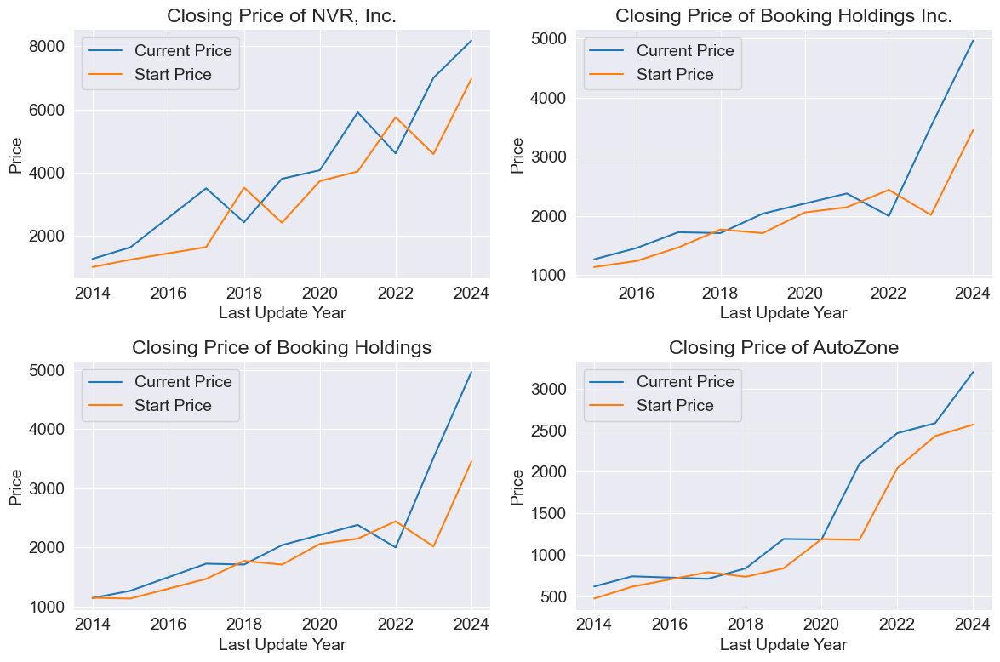

In [20]:
# Top 4 companies based on the highest current price (considering unique companies)
top_4_companies = stock_df.loc[stock_df.groupby('Company Name')['Current Price'].idxmax()] \
                           .sort_values(by=['Current Price'], ascending=False).head(4)

fig, axes = plt.subplots(2, 2, figsize=(12, 8))

for i, company_name in enumerate(top_4_companies['Company Name']):
    row = i // 2
    col = i % 2

    company_data = stock_df[stock_df['Company Name'] == company_name]

    axes[row, col].plot(company_data['Last Update Year'], company_data['Current Price'], label='Current Price')
    axes[row, col].plot(company_data['Last Update Year'], company_data['Start Price'], label='Start Price')
    axes[row, col].set_ylabel('Price')
    axes[row, col].set_xlabel('Last Update Year')
    axes[row, col].set_title(f"Closing Price of {company_name}")
    axes[row, col].legend()

plt.tight_layout()
plt.show()

**Key Insights:**

**Overall Upward Trend:** All four companies (NVR, Booking Holdings - shown twice, and AutoZone) exhibit a general upward trend in both their starting and current stock prices over the analyzed period. This suggests positive long-term growth for all four.
- **Varying Growth Rates:** NVR shows the most dramatic price increase, particularly in recent years, indicating potentially higher growth potential but also potentially higher risk. Booking Holdings demonstrates more moderate and consistent growth. AutoZone also shows consistent growth but with less volatility compared to NVR.
- **Current Price Outperformance:** In all cases, the current price significantly exceeds the starting price, demonstrating a positive return on investment for all four companies.
- **Volatility Differences:** NVR appears to have the highest volatility, with more pronounced fluctuations in price. AutoZone exhibits the most stable and consistent growth. Booking Holdings falls in between, showing growth with some fluctuations, including a noticeable dip and recovery around 2022.
**Key Takeaways:**
- **Strong Performers:** All four companies have demonstrated strong long-term growth, making them potentially attractive investments.
- **Risk-Return Tradeoff:** NVR's higher growth comes with increased volatility, suggesting a higher risk-return profile. AutoZone's more stable growth indicates a potentially lower risk. Booking Holdings offers a balance, but the cause of the 2022 dip warrants further investigation.
- **Data Anomaly:** The duplicate Booking Holdings data needs to be addressed for accurate analysis.  It's important to verify the data source and ensure that the correct information is being displayed.  Future analysis should focus on the unique insights from the other companies and not be diluted by duplicate information.
- **Further Analysis Needed:** To make informed investment decisions, further research is needed, including analyzing trading volume, comparing performance to market indices, and understanding the reasons behind price fluctuations.  Also, calculating key metrics like CAGR, standard deviation, and Sharpe Ratio would provide a more quantitative assessment of each stock's performance.

In [21]:
stock_df

,Symbol,Company Name,Sector,Industry,Start Date,Last Update,Start Price,Current Price,YTD Change,Market Cap,P/E Ratio,Dividend Yield,Average Volume,Year High,Year Low,Index,Year,Start Year,Last Update Year
0,AMZN,Amazon,Retailing,Retailing,2015-01-01,2015-12-31,15.43,33.79,1.1907,2.300000e+12,35.470116,0.00990,75960476.0,34.82,14.26,DOW30,2015,2015,2015
1,NVDA,Nvidia,Information technology,Information technology,2015-01-01,2015-12-31,0.48,0.80,0.6645,3.330000e+12,30.564445,0.00030,310268111.0,0.83,0.45,DOW30,2015,2015,2015
2,NKE,Nike,Clothing industry,Clothing industry,2015-01-01,2015-12-31,42.35,56.30,0.3294,1.053100e+11,28.073051,0.02080,7610102.0,61.43,40.42,DOW30,2015,2015,2015
3,CRM,Salesforce,Information technology,Information technology,2015-01-01,2015-12-31,58.91,77.96,0.3234,3.041800e+11,28.306879,0.00480,4153068.0,82.44,54.64,DOW30,2015,2015,2015
4,MCD,McDonald's,Food industry,Food industry,2015-01-01,2015-12-31,72.32,94.77,0.3104,2.023100e+11,22.473152,0.02510,6505149.0,96.45,68.84,DOW30,2015,2015,2015
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
6140,ENPH,Enphase Energy,Information Technology,Semiconductor Materials & Equipment,2024-01-01,2024-12-31,131.24,68.68,-0.4767,9.670960e+09,18.577587,0.01500,3982714.0,141.63,58.33,SP500,2024,2024,2024
6141,CE,Celanese,Materials,Specialty Chemicals,2024-01-01,2024-12-31,151.69,69.21,-0.5438,7.261596e+09,7.281005,0.04230,1155503.0,169.57,66.73,SP500,2024,2024,2024
6142,INTC,Intel,Information Technology,Semiconductors,2024-01-01,2024-12-31,47.17,20.05,-0.5749,8.602278e+10,20.405136,0.02240,61634909.0,49.64,18.51,SP500,2024,2024,2024
6143,MRNA,Moderna,Health Care,Biotechnology,2024-01-01,2024-12-31,112.50,41.58,-0.6304,1.649330e+10,-4.931748,0.01305,5139299.0,170.47,35.80,SP500,2024,2024,2024


In [22]:
fig = px.histogram(stock_df,
                   x = 'Dividend Yield',
                   marginal = 'box',
                   color_discrete_sequence = ['red'],
                   title = 'Distribution of Dividend Yield')
fig.update_layout(bargap = 0.1)

**Key Insights:**

- **Bimodal Distribution:** The histogram reveals a bimodal distribution, with distinct peaks around 0.00 (0%) and 0.02 (2%).  This indicates dividend yields tend to cluster around these two values.
- **Dominant Zero Yield:**  A large proportion of companies have a 0% dividend yield, as shown by the tall bar on the far left. This suggests many companies don't distribute dividends.
- **Right Skewness:** The distribution is right-skewed, with a long tail extending toward higher yields. This is also evident in the box plot.
- **Box Plot Summary:**
    * **Median:** The median dividend yield (line inside the box) is around 2%, suggesting the typical yield for dividend-paying companies.
    * **Interquartile Range (IQR):** The box spans from Q1 (1.34%) to Q3 (2.83%), representing the middle 50% of the data.
    * **Whiskers:**  The whiskers extend to the farthest points within 1.5 times the IQR from the box.
    * **Outliers:** Points beyond the whiskers are considered outliers, representing companies with unusually high dividend yields.  The chart highlights the maximum value (0.1063 or 10.63%) and the upper fence (0.0499 or 4.99%).

**Key Takeaways:**
-**Many Non-Dividend Payers:** A substantial portion of companies do not pay dividends, possibly due to reinvestment in growth, lack of profitability, or differing dividend policies.
- **Typical Yield Around 2% for Dividend Payers:** For companies that *do* pay dividends, the typical yield is around 2%, as indicated by the median and the secondary peak.
- **High Yield Potential, but with Caution:**  Outliers suggest the possibility of high dividend yields, but these should be approached cautiously as they can indicate higher risk. Due diligence is essential.
- **Bimodal Distributions Common:** Bimodal distributions often reflect distinct subgroups. Here, they likely represent companies that don't pay dividends versus those that do.
- **Consider Industry Context:**  Industry-specific analysis is important. Some industries naturally have higher dividend payouts.


Text(0.5, 1.0, 'Distribution of Current Stock Prices')

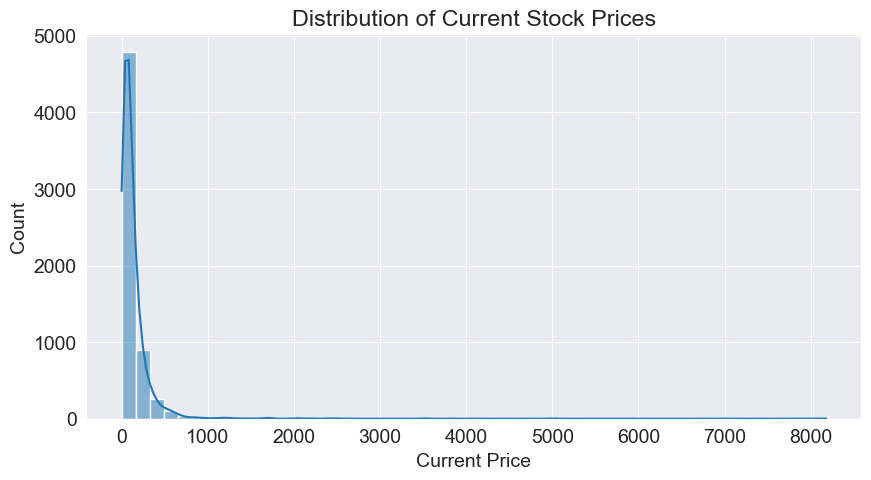

In [23]:
# Histogram of Stock Prices
plt.figure(figsize=(10, 5))
sns.histplot(stock_df['Current Price'], bins=50, kde=True)
plt.title("Distribution of Current Stock Prices")

## Analysis of Current Stock Price Distribution

**Key Insights:**

- **Highly Skewed Distribution:** The histogram reveals a strongly right-skewed distribution of current stock prices.  This indicates that a large majority of stocks have relatively low prices, while only a small fraction have very high prices.
- **Concentration at the Low End:** The tallest bar on the left shows a massive concentration of stocks priced below $1000 (and likely even much lower, closer to zero). This suggests that most stocks fall into this lower price range.
- **Long Tail:** The long tail extending to the right signifies the presence of a few stocks with extremely high current prices, stretching into the thousands of dollars. These outliers are far less frequent but significantly influence the distribution's skewness.
- **No Obvious Modality:**  There's no clear evidence of distinct peaks or modes in the data, apart from the dominant concentration at the low end.  This suggests a relatively continuous distribution, albeit heavily skewed.

**Key Takeaways:**
- **Typical Stock Market Characteristic:** The observed distribution is a common characteristic of stock markets, where many companies are smaller or have lower valuations, and only a few achieve very high stock prices.
- **Potential for High-Value Outliers:** While most stocks are low-priced, the existence of the long tail suggests that there's a possibility of significant returns if one invests in a company that eventually becomes one of the high-priced outliers.
- **Median vs. Mean Disparity:** Due to the skewness, the median stock price will likely be much lower than the mean (average) stock price.  The mean is heavily influenced by the few high-priced outliers.


Text(0.5, 1.0, 'P/E Ratio vs Market Cap')

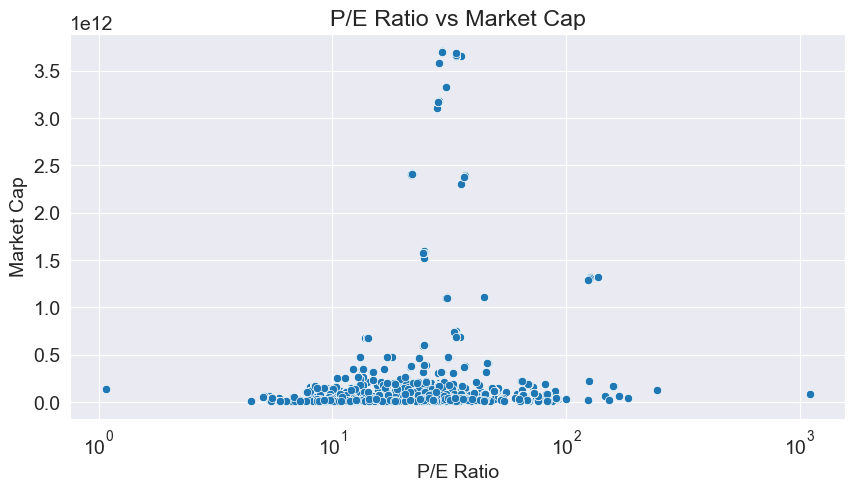

In [24]:
# Market Cap vs. P/E Ratio (Scatter Plot)
plt.figure(figsize=(10, 5))
sns.scatterplot(x=stock_df['P/E Ratio'], y=stock_df['Market Cap'])
plt.xscale('log')  # Log scale for better visualization
plt.title("P/E Ratio vs Market Cap")

## Analysis of P/E Ratio vs. Market Cap Scatter Plot

**Key Insights:**
- **Weak or Non-Linear Relationship:** The scatter plot suggests a weak or non-linear relationship between P/E ratio and market capitalization.  While there's a wide dispersion of points, there isn't a clear linear trend (positive or negative) that stands out.
- **Concentration in Low-Left:** A large number of data points are clustered in the bottom-left corner, indicating that many companies have both low P/E ratios and low market caps.
**Key Takeaways:**
- **Market Cap Alone Doesn't Predict P/E:** Market capitalization alone is not a strong predictor of a company's P/E ratio, at least based on this visualization. Other factors, such as industry, growth prospects, financial performance, and market sentiment, likely play a more significant role in determining P/E.
- **Low End Concentration:** The concentration of companies with low P/E ratios and low market caps is typical in the stock market.  These might be smaller, less established companies, or companies in mature industries.
- **High Growth Potential?** The outliers with high P/E ratios and high market caps could represent companies with high growth potential, but they also carry higher risk.


Text(0.5, 1.0, 'Dividend Yield by Sector')

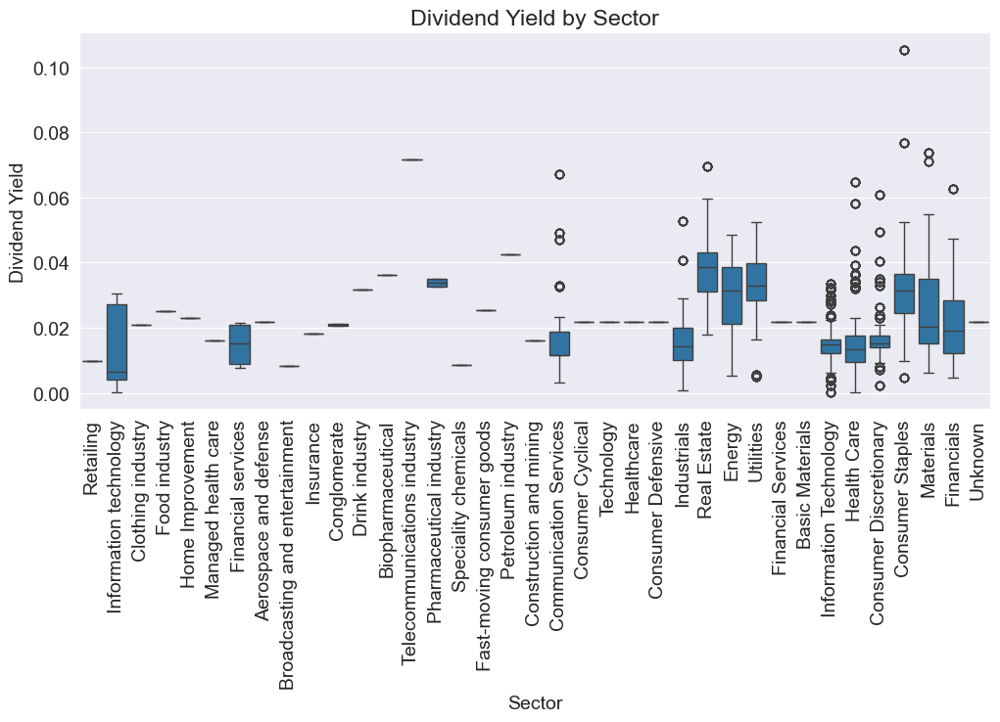

In [25]:
# Boxplot of Dividend Yields by Sector
plt.figure(figsize=(12, 5))
sns.boxplot(x='Sector', y='Dividend Yield', data=stock_df)
plt.xticks(rotation=90)
plt.title("Dividend Yield by Sector")

## Analysis of Dividend Yield by Sector Box Plot

**Key Insights:**

- **Wide Range of Yields:** Dividend yields vary significantly across sectors, ranging from near 0% to over 10%. This indicates diverse dividend policies and payout levels.
- **Sector Variability:** Some sectors (e.g., Retailing, Information Technology, Clothing Industry) consistently show low yields, while others (e.g., Energy, Utilities, Real Estate) exhibit higher and more variable yields.
- **Median Differences:** The median dividend yield (line within the box) differs considerably across sectors. Utilities and Real Estate generally have higher medians than Technology or Retailing.
- **Outliers:**  Individual points outside the "whiskers" are outliers, representing companies with unusually high or low yields compared to their sector.
- **Skewness:** The median's position within the box hints at skewness. A median closer to the bottom suggests positive skew (more high values), and vice versa.

**Key Takeaways:**
- **Sector Matters:** Sector selection is crucial for dividend investors, as some sectors are inherently more generous.
- **Within-Sector Variability:** Even within a sector, yields can vary significantly, requiring company-specific research.

Text(0.5, 1.0, 'Number of Companies per Sector')

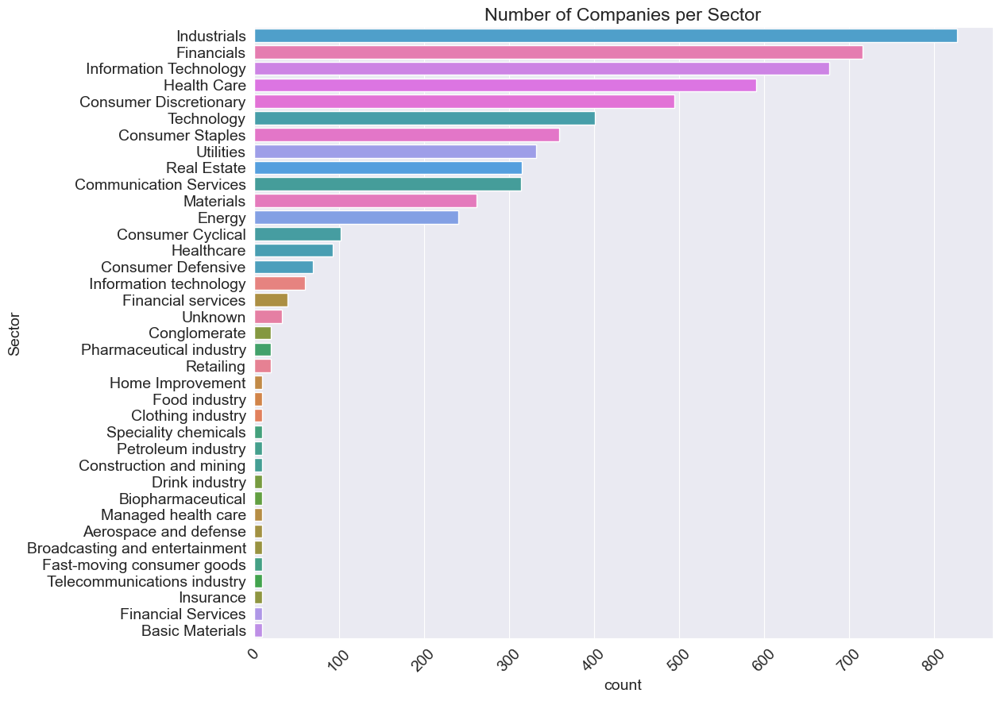

In [26]:
# Sector distribution
plt.figure(figsize=(12, 10))
sns.countplot(y=stock_df['Sector'], order=stock_df['Sector'].value_counts().index, hue=stock_df['Sector'])
plt.xticks(rotation=45)
plt.title("Number of Companies per Sector")

## Analysis of Number of Companies per Sector Bar Chart

**Key Insights:**
- **Industrials and Financials Dominate:** The Industrials and Financials sectors have the highest number of companies, significantly outpacing all other sectors.
- **Tech and Healthcare Strong:** Information Technology and Health Care sectors also demonstrate a large number of companies, indicating a substantial presence in the market.
- **Mid-Range Sectors:** Utilities, Real Estate, Communication Services, and Materials sectors have a moderate number of companies.
- **Lower Company Count Sectors:** Several sectors, including Consumer Cyclical, Consumer Defensive, Information Technology (listed again, likely a data error), etc.

**Key Takeaways**
- **Sector Concentration:** The market shows a concentration of companies in the Industrials and Financials sectors, followed by Tech and Healthcare.
- **Economic Indicators:** The distribution of companies across sectors can reflect broader economic trends and priorities.

Text(0, 0.5, 'Average Price')

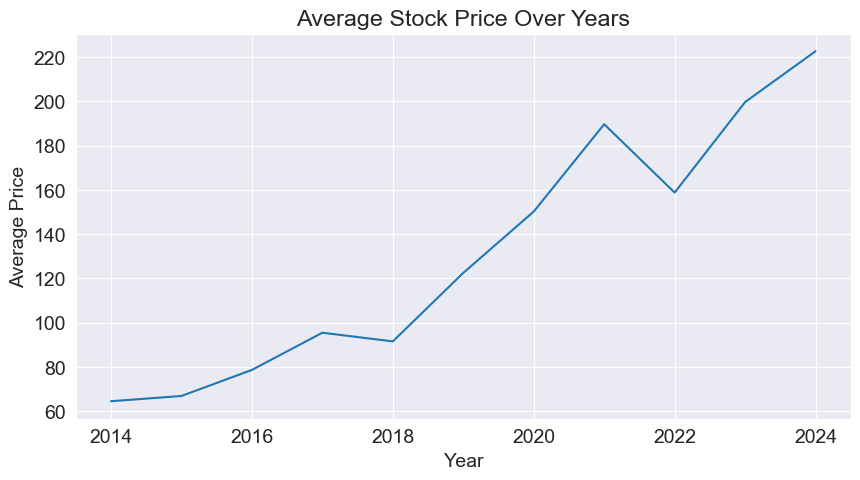

In [27]:
# Average Stock Price Over Time
avg_price_per_year = stock_df.groupby('Year')['Current Price'].mean()

plt.figure(figsize=(10, 5))
sns.lineplot(x=avg_price_per_year.index, y=avg_price_per_year.values)
plt.title("Average Stock Price Over Years")
plt.xlabel("Year")
plt.ylabel("Average Price")

## Stock Price Trends Over the Years

- **Yearly Growth Pattern**:  
  - The upward trend suggests that the stock has generally **appreciated year-over-year**.  

- **Volatility & Uncertainty**:  
  - The **shaded regions** indicate uncertainty or variability in prices.  
  - **Higher fluctuations post-2018** suggest increased market uncertainty.  

- **Key Crossovers & Trends**:  
  - **2018 Onwards**: The red line (current price) moves above the blue line consistently, indicating **strong annual gains**.  
  - **2022 Dip**: A period where the **end-of-year price drops**, possibly due to market corrections or external factors.  

### Key Takeaways  
- The stock has demonstrated **consistent annual growth**, meaning most years ended higher than they started.  
- **Market volatility exists**, but overall **positive trends dominate**.  
- The **latest surge (2023-2024)** suggests strong market performance, though future stability should be monitored.  


Text(0.5, 1.0, 'Correlation Matrix of Stock Data')

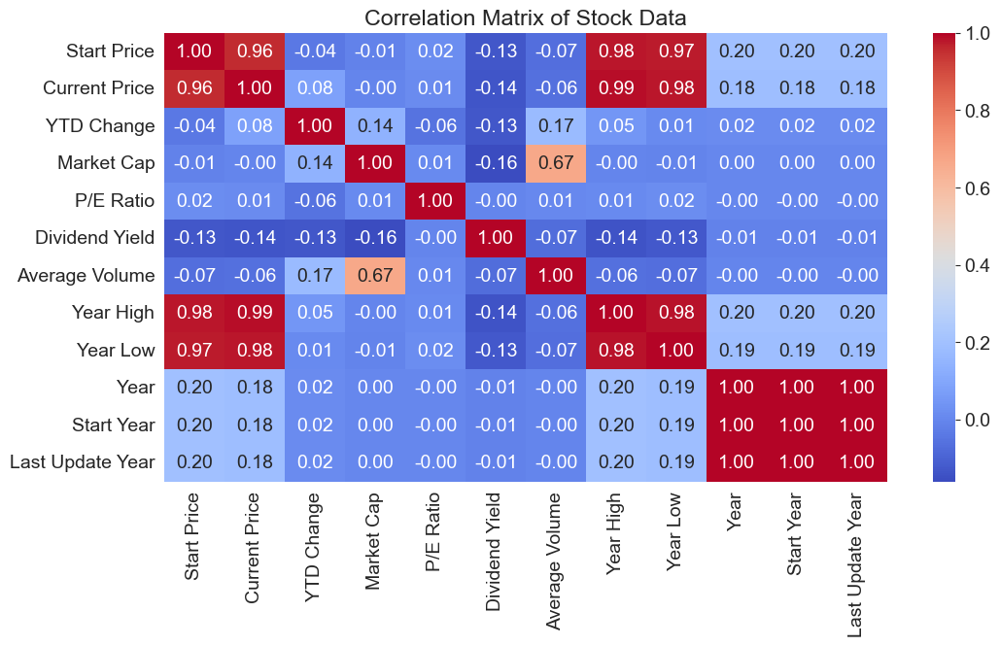

In [28]:
plt.figure(figsize=(12, 6))
sns.heatmap(stock_df.select_dtypes(include=['number']).corr(), annot=True, cmap="coolwarm", fmt=".2f")
plt.title("Correlation Matrix of Stock Data")

## Correlation Matrix Insights
- **Strong Positive Correlations**:
  - `Start Price` and `Current Price` (0.96) suggest stocks tend to maintain relative value over time.
  - `Year High` and `Year Low` both correlate strongly with `Start Price` and `Current Price`, indicating that stocks maintain general trends.

- **Moderate Correlations**:
  - `Market Cap` and `Average Volume` (0.67) suggest that larger companies tend to have higher trading volumes.

- **Weak or Negative Correlations**:
  - `Dividend Yield` shows weak correlation with most metrics, meaning dividend-paying stocks may not have strong ties to stock price changes or market cap.
  - `P/E Ratio` has minimal correlation with other variables, suggesting it behaves independently of price and volume trends.
    - Stock prices tend to **move consistently** over time, with strong historical trends.
### Key Takeaway  
- Stock prices and trading volume are **strongly interconnected**, but valuation and dividend metrics behave more independently. 
- A **multi-metric investment approach** is crucial for making well-informed decisions. 📈🚀  


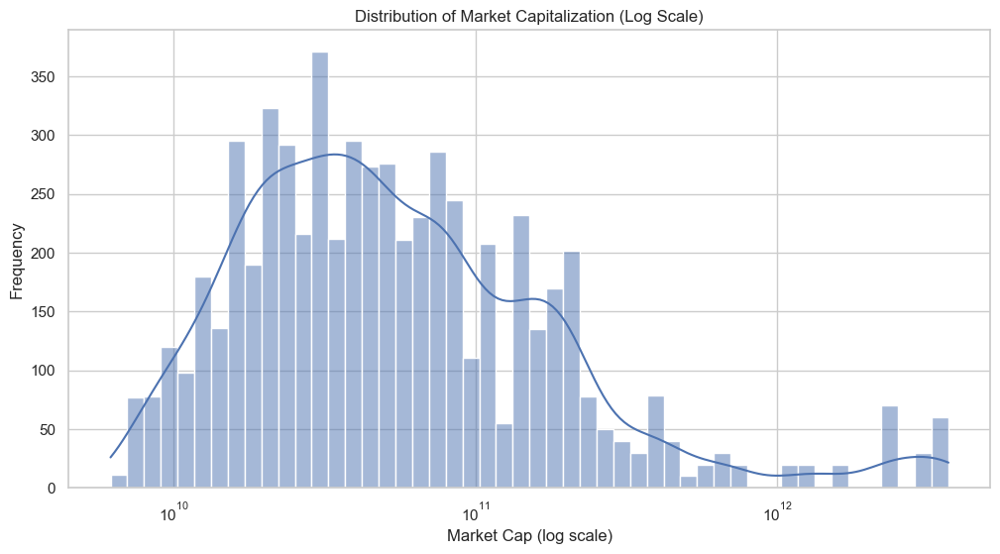

In [29]:
# Set style
sns.set_theme(style="whitegrid")

# Plot Market Cap distribution
plt.figure(figsize=(12, 6))
sns.histplot(stock_df["Market Cap"], bins=50, kde=True, log_scale=True)
plt.title("Distribution of Market Capitalization (Log Scale)")
plt.xlabel("Market Cap (log scale)")
plt.ylabel("Frequency")
plt.show()

## Distribution of Market Cap 
- **Multiple Peaks:** The distribution exhibits multiple peaks, suggesting that companies tend to cluster around specific market cap values. This could indicate different market segments or maturity levels.
- **Skewness:** The distribution appears to be right-skewed, meaning there are more companies with lower market caps and fewer companies with extremely high market caps. This is a common characteristic of market cap distributions.
- **Log Scale Impact:** Using a logarithmic scale for the x-axis helps visualize the distribution across a wide range of market cap values. It compresses the higher values and allows us to see details in the lower market cap ranges.
### Key Takeaways
- **Many small companies, few giants:** There are many more companies with smaller market caps, and far fewer with extremely large market caps.
- **Clustering:** Companies tend to group around specific market cap values (the peaks).
- **Why log scale?** The logarithmic scale is essential because it compresses the wide range of market cap values, allowing us to visualize the distribution effectively and identify clusters, particularly among smaller companies.

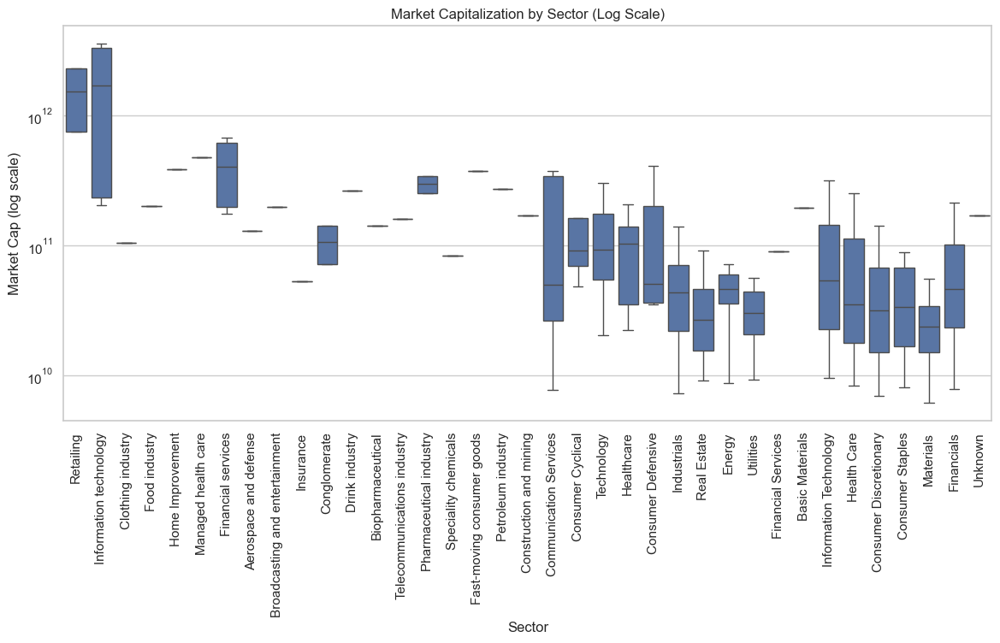

In [30]:
# Boxplot of Market Cap by Sector
plt.figure(figsize=(14, 6))
sns.boxplot(data=stock_df, x="Sector", y="Market Cap", showfliers=False)
plt.xticks(rotation=90)
plt.yscale("log")
plt.title("Market Capitalization by Sector (Log Scale)")
plt.xlabel("Sector")
plt.ylabel("Market Cap (log scale)")
plt.show()


## Analysis of Market Capitalization by Sector (Log Scale) Box Plot

**Key Insights:**
- **Wide Range of Market Caps:** The logarithmic scale on the y-axis reveals an enormous range of market capitalizations across sectors, spanning multiple orders of magnitude (from roughly 10^9 to 10^12).
- **Sector Variability:**  Different sectors exhibit significantly different market cap distributions. Some sectors (e.g., Retailing, Information Technology, Clothing Industry) have tightly clustered market caps, while others (e.g., Industrials, Financials, Consumer Discretionary) show much wider ranges.
- **Retailing Dominance:** The Retailing sector appears to have the highest median market capitalization and also contains several companies with exceptionally high market caps (outliers).
- **Financials and Industrials Spread:** Financials and Industrials show a broad spread of market caps, suggesting a mix of both large and small companies within these sectors.
- **Lower Market Cap Sectors:** Sectors like Clothing Industry, Food Industry, Home Improvement, etc., generally have lower market capitalizations and less variability within their sectors.
- **Outliers:** Several sectors have outliers, representing individual companies with exceptionally high or low market caps compared to their sector peers.

**Key Takeaways:**

- **Sector Impacts Market Cap:** The sector a company operates in significantly influences its potential market capitalization.
- **Retailing Strength:** The Retailing sector appears to house some of the largest companies overall.
- **Tech and Healthcare Size:** Information Technology and Health Care are home to many substantial companies.
- **Financials and Industrials Diversity:** Financials and Industrials encompass a wide range of company sizes.

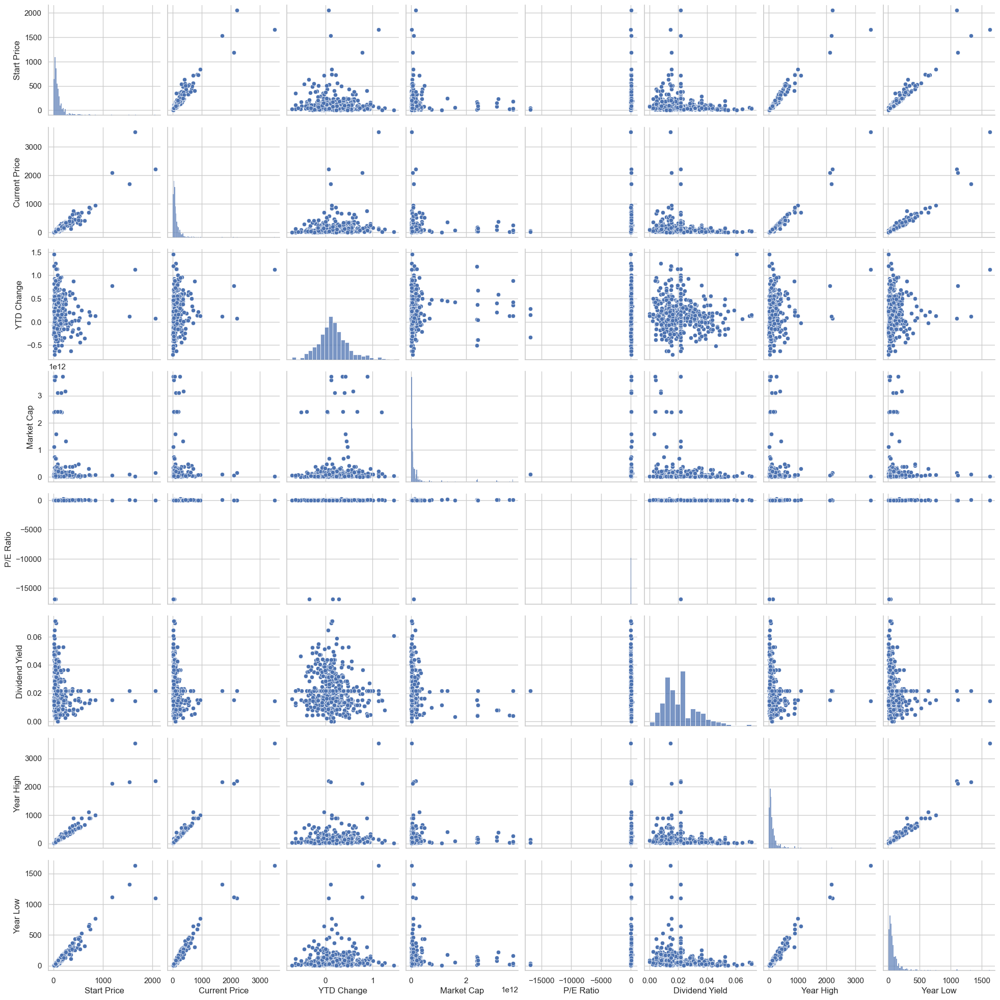

In [31]:
# Pairplot for numerical columns
numeric_cols = ["Start Price", "Current Price", "YTD Change", "Market Cap", "P/E Ratio", "Dividend Yield", "Year High", "Year Low"]
sns.pairplot(stock_df[numeric_cols].sample(500))  # Sample 500 for performance
plt.show()


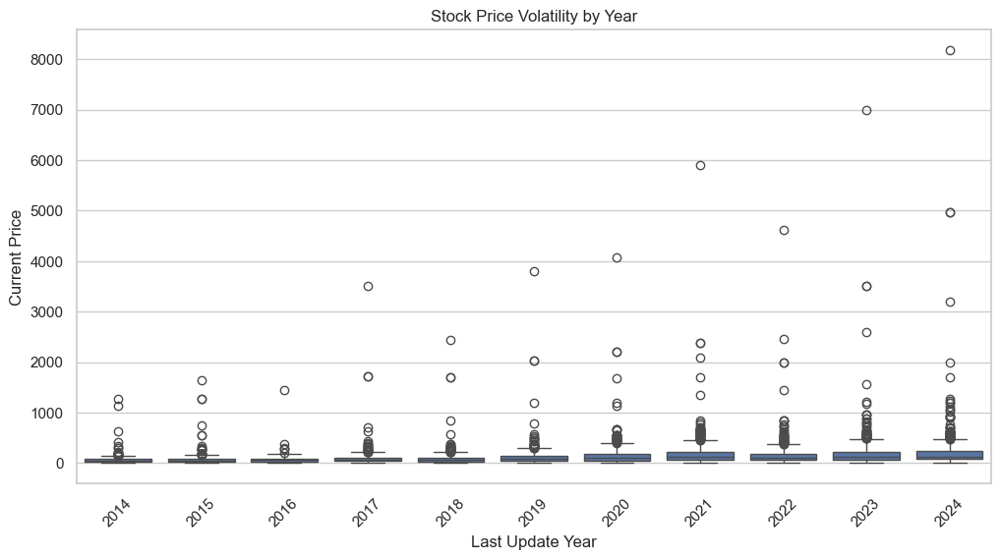

In [32]:
plt.figure(figsize=(12, 6))
sns.boxplot(data=stock_df, x="Last Update Year", y="Current Price")
plt.title("Stock Price Volatility by Year")
plt.xlabel("Last Update Year")
plt.ylabel("Current Price")
plt.xticks(rotation=45)
plt.show()


## Analysis of Stock Price Volatility by Year Box Plot

**Key Insights:**

- **Increasing Price Range:** The box plots show a clear trend of increasing price range (volatility) over the years. The boxes become taller and the whiskers extend further, indicating a wider spread of stock prices in later years.
- **More Frequent and Extreme Outliers:** The number and extremity of outliers increase significantly in later years. This indicates more frequent occurrences of both exceptionally high and exceptionally low stock prices, highlighting increased market volatility.
- **Early Years' Stability:** The box plots for earlier years (2014-2017) are relatively compact, indicating more stable stock prices with less variation.
- **2020 Onward Volatility:** A noticeable jump in volatility seems to occur around 2020, potentially coinciding with significant market events (e.g., the COVID-19 pandemic).
* **Consistent Upward Trend in Recent Years:** The median and the overall price range appear to consistently increase from 2020 onwards, suggesting a sustained period of heightened volatility.

**Key Takeaways:**

* **Volatility is Increasing:** Stock price volatility has been on a clear upward trend in recent years.
* **Higher Risk, Higher Potential Reward:**  The increased volatility suggests higher potential returns but also higher risk for investors.
* **External Factors Likely:**  The significant jump in volatility around 2020 suggests the influence of external factors on stock prices.
* **Importance of Risk Management:**  In a more volatile market, effective risk management strategies become increasingly important.

C:\Users\ADMIN\AppData\Local\Temp\ipykernel_3992\3683525274.py:4: FutureWarning:



Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.




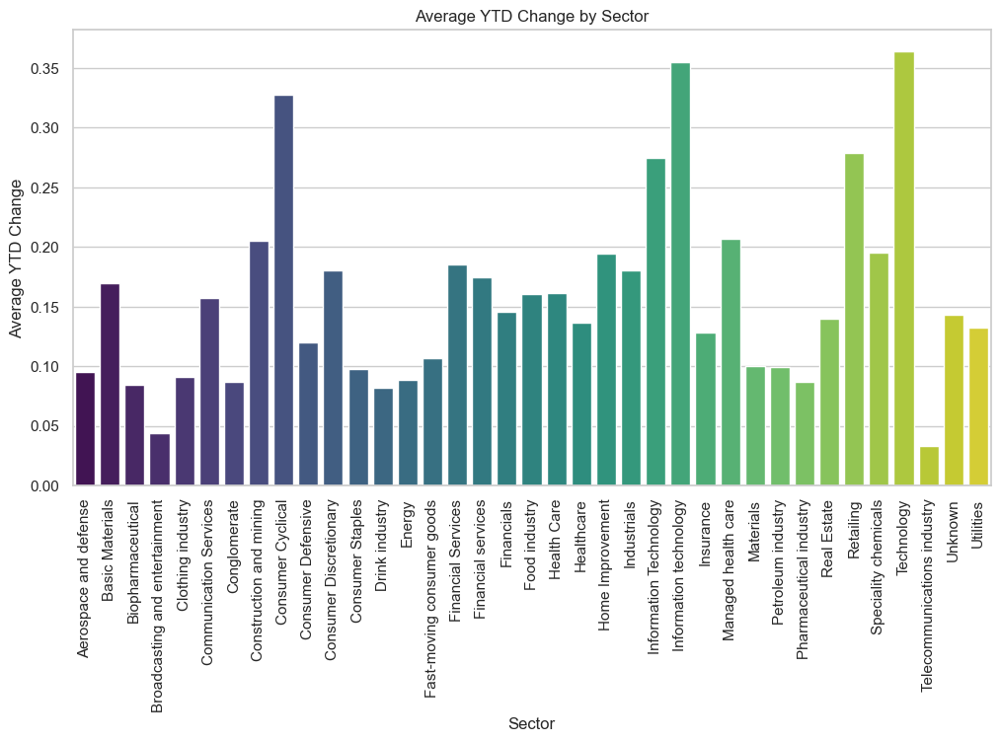

In [33]:
sector_performance = stock_df.groupby("Sector")["YTD Change"].mean().reset_index()

plt.figure(figsize=(12, 6))
sns.barplot(data=sector_performance, x="Sector", y="YTD Change", palette="viridis")
plt.title("Average YTD Change by Sector")
plt.xlabel("Sector")
plt.ylabel("Average YTD Change")
plt.xticks(rotation=90)
plt.show()

 ## Average YTD Change by Sector
- **Top Performing Sectors**:
  - **Retailing and Technology** show the highest YTD growth, indicating strong consumer spending and tech sector expansion.
  - **Information Technology and Consumer Cyclical** sectors are also performing well.

- **Moderate Performance**:
  - **Industrials, Financials, and Healthcare** sectors show steady growth.

- **Lowest Performing Sectors**:
  - **Telecommunications, Broadcasting, and Utilities** have the lowest YTD changes, reflecting stability but slower growth.
  - **Defense and Energy sectors** also show relatively low growth.
### Key Takeaway  
- High-growth sectors like **Technology and Retailing** drive market expansion 
- **Traditional industries provide stability** with moderate or low growth.
- Investors should balance between **growth opportunities and defensive sectors** to manage risk effectively. 


In [34]:
fig = px.scatter(
    stock_df,
    x="Market Cap",
    y="Dividend Yield",
    log_x=True,
    title="Dividend Yield vs. Market Cap",
    hover_data=["Company Name", "Sector"],
    marginal_x="histogram",
    marginal_y="box"
)
fig.show()

# Dividend Yield vs. Market Cap

**Key Insights:**

- **Inverse Relationship:** A clear inverse relationship exists.  As market capitalization (company size) increases, dividend yield generally decreases.  Conversely, smaller companies tend to offer higher dividend yields.
- **High Yield Concentration at Lower Market Caps:**  A significant portion of companies with high dividend yields (above 6%) are clustered in the lower market cap range (below $100 Billion). This suggests smaller companies use higher dividends to attract investors.
- **Low Yield Concentration at Higher Market Caps:** Larger companies (market cap above $1 Trillion) predominantly exhibit lower dividend yields, typically below 4%.  This implies that large, established companies prioritize reinvestment in growth over high dividend payouts.
- **Outliers Exist:**  While the trend is clear, some large-cap companies still offer relatively high dividend yields.  These exceptions suggest other factors beyond market cap influence dividend policy.

**Key Takeaways:**
- **Growth vs. Income Trade-off:** The chart highlights the trade-off between growth potential and income generation.  Smaller companies offer higher potential growth but may distribute less income via dividends. Larger companies offer more stable income (though often at lower yields) but potentially slower growth.
- **Risk Considerations:** Higher dividend yields can sometimes reflect higher risk. Smaller companies might need to offer higher yields to compensate investors for perceived higher risk.  Investors should carefully research individual companies before assuming a high yield equates to a good investment.
- **Investment Strategy Implications:**  This relationship has implications for investment strategy. Income-seeking investors might focus on smaller or mid-cap companies with higher yields, while growth-oriented investors might prefer larger companies with lower yields but higher growth potential.  Diversification across different market cap segments can be a useful strategy.

In [35]:
# Sample 6 unique companies for clarity
sample_companies = stock_df["Company Name"].drop_duplicates().sample(6, random_state=42)
sample_data = stock_df[stock_df["Company Name"].isin(sample_companies)]

fig = px.line(
    sample_data,
    x="Last Update Year",
    y="Current Price",
    color="Company Name",
    title="Stock Price Trends for Sample Companies",
    markers=True
)
fig.show()